In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.animation as animation
from IPython.core.pylabtools import figsize
from scipy.optimize import newton, root
from numba import njit
import numba as nb
import time
import pickle
from tqdm.notebook import tqdm

from IPython.display import HTML, display
plt.style.use('../aslak.mplstyle')
plt.rcParams['figure.figsize']=[7,3]

In [20]:
#data processing functions

def MakeYearly(data):
    '''
    Takes a data array and returns the mean of the data for each year
    :param data:
    :return:
    '''
    meandata = np.mean(data[:,1:], axis = 1)
    timeseries = data[:,0]
    return meandata, timeseries

def Crop(time, precip):
    '''
    Crop the data to start at 2015
    :param time: Time array corresponding to precip indecies
    :param precip: precipitation data array
    :return: the cropped precipitation and time arrays
    '''
    index = np.where(time == 2015)
    CroppedTime = time[index[0][0]:]
    CroppedPrecip = precip[index[0][0]:]
    return CroppedPrecip, CroppedTime

def ProcessPrecipitation(data):
    '''
    :param data: Precipitation data array
    :return: Precipitation, mean thorugh the months and the deviation from the mean and cropped to start at 2015
    '''
    precip, time = MakeYearly(data)
    precip, time = Crop(time, precip)
    return precip, time

def process_temp(T):
    '''
    :param T: Temp array
    :return: Temp, mean thorugh the months and the deviation from the mean
    '''
    T_yearly = np.mean(T[:,1:], axis = 1)
    t_mean = np.mean(T_yearly[0:12])
    T_Y_deviation = T_yearly - t_mean
    return T_Y_deviation


#physical functions
@njit(fastmath=True)
def bdot(z, z_ela,precip, i):
    beta = 0.006 * np.sqrt(precip[i]*1e-3) * 30
    return (z-z_ela)*beta

def A_fun(T):
    A1 = 3.985e-13 * np.exp(-60e3 / (R * T))
    A2 = 1.916e3 * np.exp(-139e3 / (R * T))
    return np.maximum(A1, A2)

def calculate_inital_height(L, x):
    '''
    uses perfect plasticity to make a approximate initial height
    :param L: glacier length
    :param x: grid point along glacier surface
    :return: initial height array
    '''
    x_halved = x[0:int(len(x)/2)]
    h = np.sqrt(2*tau_0/(rhoi*g) * (L-x_halved))
    h = np.append(h, np.zeros(int(len(x)/2)))
    return h

@nb.njit( fastmath=True)
def norm_pdf(x, mu, sigma):
    """
    Calculate normal probability density function manually
    """
    mu = mu.reshape(-1, 1)  # Ensure mu is a column vector
    x = x.reshape(1, -1)

    dist_array = np.zeros((mu.shape[0], x.shape[1]))
    a = mu.shape[0]
    for i in nb.prange(a):
        mu_val = mu[i,0]
        # Manual implementation of normal PDF
        z = (x[0,:] - mu_val) / sigma
        dist_array[i,:] = (1 / (sigma * np.sqrt(2 * np.pi))) * np.exp(-0.5 * z**2)
    return dist_array

@nb.njit( fastmath=True)
def normalPDD(Tmu, sigma):

    T_max = max(Tmu) + 5 * sigma
    T = np.linspace(0, T_max, 100)

    # Reshape T for broadcasting
    T_reshaped = T.reshape(1, -1)  # Shape: (1, 1000)
    Tmu_reshaped = Tmu.reshape(-1, 1)  # Shape: (n, 1)

    # Calculate probability density * temperature for each Tmu and T combination
    # Result shape: (n, 1000)
    dist = norm_pdf(T_reshaped, mu= Tmu_reshaped, sigma=sigma) * T_reshaped
    # Integrate along axis=1 for each row
    fpd_array = np.zeros((Tmu.shape[0], 1))
    for i in nb.prange(dist.shape[0]):
        fpd_array[i] = np.trapz(dist[i, :], x=T)
    return fpd_array

@nb.njit(fastmath=True)
def norm_cdf_accumulation(Tmu,sigma):
    T_min =  - 10 * sigma
    T = np.linspace(T_min, 1, 100)

    # Reshape T for broadcasting
    T_reshaped = T.reshape(1, -1)  # Shape: (1, 1000)
    Tmu_reshaped = Tmu.reshape(-1, 1)  # Shape: (n, 1)

    # Calculate probability density * temperature for each Tmu and T combination
    # Result shape: (n, 1000)
    dist = norm_pdf(T_reshaped, mu=Tmu_reshaped, sigma=sigma)
    # Integrate along axis=1 for each row
    fpd_array = np.zeros((Tmu.shape[0], 1))

    for i in nb.prange(dist.shape[0]):
        fpd_array[i] = np.trapz(dist[i, :], x=T)
    return fpd_array

@nb.njit(fastmath=True)
def smb_func_test(Tmonth, sigma, z, P0, p_g, T_lapse=-7 * 1e-3, PDD_factor=2 * 1e-3, cp=0.08):
    '''
    calculates the monthly surface mass balance (smb) as a function of temperature using a positive degree day (PDD) model.
    :param Tmonth: monthly mean temperature
    :param sigma: monthly mean temperature swings

    :param z: height over sea level
    :param t_lapse: temperature lapse rate
    :param PDD_factor: PDD factor
    :param P0: precipitation at sea level
    :return: smb: surface mass balance
    '''

    T_glacier_surface = float(Tmonth) + T_lapse * z
    fPDD = normalPDD(T_glacier_surface, sigma)
    ablation = PDD_factor * fPDD * 30
    P = (P0+p_g) * np.exp(cp * (T_glacier_surface)) * 1e-3 * 30
    P = P.reshape(-1,1)
    Pcold = norm_cdf_accumulation( T_glacier_surface, sigma).reshape(-1,1)
    accumulation = P * Pcold
    smb = accumulation - ablation

    return smb

def getPDD(glacier, Tmonth, sigma, P0, p_g ,T_lapse= -7*1e-3):

    #

    # target_elevation = 1/4 *(glacier['zmean_m']+ 1* glacier['zmin_m'])
    target_elevation = glacier.zmean_m
    z_median = np.array([target_elevation])
    fpd_guess = 8.2e-2
    z_root= newton(smb_at_Median, fpd_guess,args=(Tmonth, sigma, z_median, P0, T_lapse, p_g))
    # print(f'z_root{z_root}, target_elevation{target_elevation}')
    return z_root



def smb_at_Median(Fpd, Tmonth, sigma, z_median, P0, T_lapse, p_g):
    """
    Function to find the PDD factor that gives zero SMB at median elevation.
    First arg (Fpd) is what fsolve will vary, the rest are fixed
    """
    #Tmonth, sigma, z, P0, p_g, T_lapse=-7 * 1e-3, PDD_factor=2 * 1e-3, cp=0.08
    a = smb_func_test(Tmonth, sigma, z_median, P0, p_g, T_lapse, Fpd, cp=0.08)
    return float(a[0])

Precip_Scenario_dict = {
    'ssp126' :  '../Cmip6_data/Model_mean/precip/icmip6_pr_mon_modmean_ssp126_-176.13--126E_52.-69.5N_firstyear-lastyear_n_su.dat.txt',
    'ssp245' :  '../Cmip6_data/Model_mean/precip/icmip6_pr_mon_modmean_ssp245_-176.13--126E_52-69.5N_firstyear-lastyear_n_su.dat.txt',
    'ssp370' :  '../Cmip6_data/Model_mean/precip/icmip6_pr_mon_modmean_ssp370_-176.13--126E_52-69.5N_firstyear-lastyear_n_su.dat.txt',
    'ssp585' :  '../Cmip6_data/Model_mean/precip/icmip6_pr_mon_modmean_ssp585_-176.13--126E_52-69.5N_firstyear-lastyear_n_su.dat.txt',
}
Tas_Scenario_dict = {
    'ssp126' :  '../Cmip6_data/Model_mean/Tas/icmip6_tas_mon_modmean_ssp126_-176.13--126E_52-69.5N_firstyear-lastyear_n.dat.txt',
    'ssp245' :  '../Cmip6_data/Model_mean/Tas/icmip6_tas_mon_modmean_ssp245_-176.13--126E_52-69.5N_firstyear-lastyear_n.dat.txt',
    'ssp370' :  '../Cmip6_data/Model_mean/Tas/icmip6_tas_mon_modmean_ssp370_-176.13--126E_52-69.5N_firstyear-lastyear_n.dat.txt',
    'ssp585' :  '../Cmip6_data/Model_mean/Tas/icmip6_tas_mon_modmean_ssp585_-176.13--126E_52-69.5N_firstyear-lastyear_n.dat.txt',
}

#
#
# Precip_Scenario_dict = {
#     'ssp126' :  '../Cmip6_data/GFDL-ESM4/Alaska/precip/icmip6_pr_mon_GFDL-ESM4_ssp126_-176-.126E_52-69N_firstyear-lastyear_n_su_000.dat.txt',
#     'ssp245' :  '../Cmip6_data/GFDL-ESM4/Alaska/precip/icmip6_pr_mon_GFDL-ESM4_ssp245_-176--126E_52-69N_firstyear-lastyear_n_su_000.dat.txt',
#     'ssp370' :  '../Cmip6_data/GFDL-ESM4/Alaska/precip/icmip6_pr_mon_GFDL-ESM4_ssp370_0-360E_-90-90N_firstyear-lastyear_n_su_000.dat.txt',
#     'ssp585' :  '../Cmip6_data/GFDL-ESM4/Alaska/precip/icmip6_pr_mon_GFDL-ESM4_ssp585_-176--126E_52-69N_firstyear-lastyear_n_su_000.dat.txt',
# }
# Tas_Scenario_dict = {
#     'ssp126' :  '../Cmip6_data/GFDL-ESM4/Alaska/Tas/icmip6_tas_mon_GFDL-ESM4_ssp126_-176--127E_52-69N_firstyear-lastyear_n_000.dat.txt',
#     'ssp245' :  '../Cmip6_data/GFDL-ESM4/Alaska/Tas/icmip6_tas_mon_GFDL-ESM4_ssp245_-176--127E_52-69N_firstyear-lastyear_n_002.dat.txt',
#     'ssp370' :  '../Cmip6_data/GFDL-ESM4/Alaska/Tas/icmip6_tas_mon_GFDL-ESM4_ssp370_-176--126E_52-69N_firstyear-lastyear_n_000.dat.txt',
#     'ssp585' :  '../Cmip6_data/GFDL-ESM4/Alaska/Tas/icmip6_tas_mon_GFDL-ESM4_ssp585_-176--126E_52-69N_firstyear-lastyear_n_000.dat.txt',
# }

climate_hist_dict = {
 '1851-1870_hist' : [1851-1850, 1870-1850],
 '1901-1920_hist' : [1901-1850, 1920-1850],
 '1951-1970_hist' : [1951-1850, 1970-1850],
 '1995-2014_hist' : [1995-1850, 2014-1850],
 '2021-2040_hist' : [2021-1850, 2040-1850],
 '2041-2060_hist' : [2041-1850, 2060-1850],
 '2061-2080_hist' : [2061-1850, 2080-1850],
 '2081-2100_hist' : [2081-1850, 2100-1850],
}

def load_andprocess(scenario,period):
    """
    Load, process, and combine precipitation and temperature scenario data for a specified
    climate period. This function retrieves data paths based on the provided scenario, loads
    the data, processes it to match the given period, and converts temperatures from Kelvin
    to Celsius.

    :param scenario: The name of the climate scenario to load precipitation and temperature
        data for.
    :type scenario: str
    :param period: The name of the climate period defining the range of data to process.
    :type period: str
    :return: A combined numpy array with columns representing time, cropped precipitation,
        and cropped temperature (in Celsius), cal has indices [mean_temp, mean Precip].
    :rtype: numpy.ndarray
    """
    locp = Precip_Scenario_dict[scenario]
    locT = Tas_Scenario_dict[scenario]
    datp = np.loadtxt(locp, encoding='UTF-8')
    datT = np.loadtxt(locT, encoding='UTF-8')
    period = climate_hist_dict[period]
    # time = dat[period[0]:period[1],0].reshape(-1, 1)
    time = np.linspace(0, 19, num = 19*12)
    Mean_Temperature = np.mean(datT[136:155,1:].reshape(-1, 1))+0.69-273.15
    Mean_Precipitation = np.mean(datp[136:155,1:].reshape(-1, 1))

    croppedPrecip = np.concatenate(datp[period[0]:period[1],1:].reshape(-1, 1))
    croppedTas = np.concatenate(datT[period[0]:period[1],1:].reshape(-1, 1)) - 273.15

    out = np.column_stack((time, croppedPrecip, croppedTas))
    cal = np.array([Mean_Temperature, Mean_Precipitation])

    return out, cal

def rolling_average(array):
    if len(array)%12 == 0:
        new_array = array.reshape(-1, 12).mean(axis=1)
    else:
        cal = len(array)%12
        new_array = array[:-cal].reshape(-1, 12).mean(axis=1)
    return new_array

def get_MSE(vol):
    MSe = vol *rhoi /ocean_density /A_ocean
    return MSe


In [21]:
# Ts = z_g* -7*1e-3 + cal2[0]
# p = cal1[1] * np.exp(0.02 * (Ts)).reshape(-1, 1)
# Pcold = norm_cdf_accumulation(Ts, 7.5).reshape(-1, 1)* 1e-3 * 30
# fig,ax = plt.subplots(nrows=3,ncols=1,figsize=(10,10))
# ax[0].plot(Ts,Pcold)
# ax[0].set_title('Pcold')
# ax[1].plot(Ts,p)
# ax[1].set_title('p')
# ax[2].plot(Ts,Pcold*p)
# # print(z_g)

In [22]:
# glacier = Alaska.iloc[10]
# out, cal = load_andprocess('ssp126', '2081-2100_hist')
# #
# start = time.time()
# pdd = getPDD(glacier, cal[0], sigma=np.std(out[:,2]), P0=cal[1])
#
# mass_balance = smb_func(Tmonth = cal[0], sigma=np.std(out[:,2]), P0 = cal[1], PDD_factor = pdd, z = zbed)
# end = time.time()
# print(f'Time taken: {end-start} seconds')
# fig, ax = plt.subplots(nrows=3, ncols = 1, figsize=(10, 10))
# ax[0].plot(zbed,mass_balance)
# ax[0].set_title('Mass balance')
# ax[1].plot(zbed,acccum)
# ax[1].set_title('Accumulation')
# ax[2].plot(zbed,abla)
# ax[2].set_title('Ablation')

# initializing the geometry and constants

In [23]:
#setting physcial constants
sec_per_year = 365.25 * 24 * 60 * 60
sec_per_month = sec_per_year/ 12
mon_year = 12 * 19
rhoi = 900  # kg_is/m3
ocean_density = 1028 #kg_ocean/m3
A_ocean = 3.625 *1e8 # area of the ocean in m2
n = 3
R = 8.31446261815324  # J/mol/K
g = 9.82
N = 50
fs = 5.7 * 1e-23
tau_0 = 1e5 # pa
# ice plascicity constant
A = A_fun(273.15-10)


In [24]:
#reading RGI data
Alaska = pd.read_csv('../Rgi/RGI2000-v7-C- Alaska/RGI2000-v7.0-G-01_alaska-attributes.csv')
glacier = Alaska.iloc[1]


/var/folders/zm/jhkrt2q10p1fy8tnqf8pvn0r0000gn/T/ipykernel_21194/1557793276.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return float(a[0])
/var/folders/zm/jhkrt2q10p1fy8tnqf8pvn0r0000gn/T/ipykernel_21194/3979917525.py:31: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


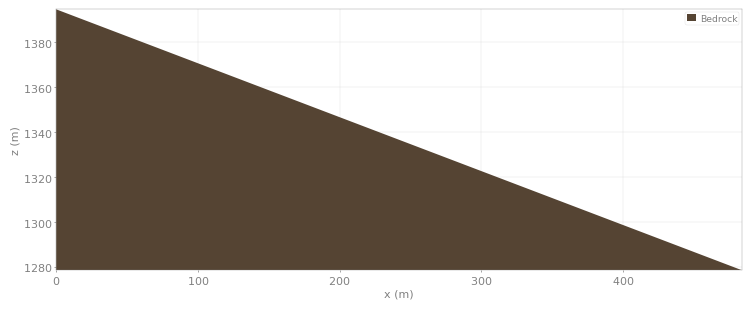

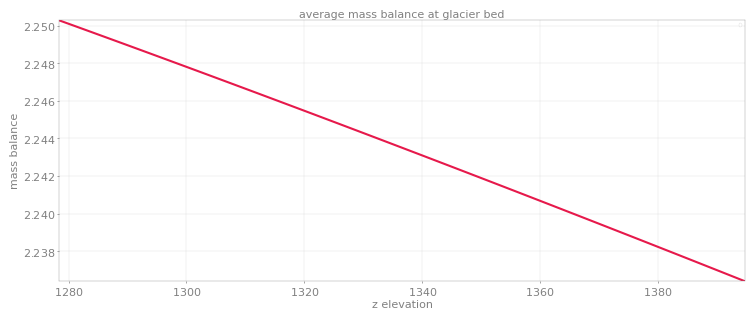

In [25]:
#plot of mass balance
out, cal = load_andprocess('ssp126', '1995-2014_hist')
pdd = getPDD(glacier, cal[0], sigma= 7.5, P0=cal[1], p_g=30)
length = glacier.lmax_m
minelev,maxelev = glacier.zmin_m, glacier.zmax_m
month = 1
E = glacier.zmean_m
x = np.linspace(0,length,N) #x-location of the grid nodes
zbed = maxelev - x*(maxelev-minelev)/length
 # int for choosing beta, to calculate bdot

plt.figure(dpi=100)
plt.fill_between(x,zbed,np.min(zbed),fc='#554433', label = 'Bedrock')
plt.ylabel('z (m)')
plt.xlabel('x (m)')
plt.legend()
plt.figure(dpi=100)
# plt.axhline(E,color='k')
#linear mass balance
# inta = 1
# plt.fill_betweenx(zbed,bdot(zbed,E,out[1,:],inta),0*zbed,where=bdot(zbed,E,out[1,:],inta)>=0,fc='#99aaff', label = 'Positive mass balance')
# plt.fill_betweenx(zbed,bdot(zbed,E,out[1,:],inta),0*zbed,where=bdot(zbed,E,out[1,:],inta)<=0,fc='#ffaa99', label = 'Negative mass balance')
#Positive degree day mass balance
plt.title('average mass balance at glacier bed')
# mass_balance = smb_func(Tmonth = cal[0], sigma=7.5, P0 = cal[1], PDD_factor = pdd, z = zbed)[:,0]
mass_balance = smb_func_test(Tmonth=out[month,2], sigma=7.5, P0=out[month,1], PDD_factor=pdd, z=zbed, p_g=90, cp = 0.01)[:,0]
plt.plot(zbed,mass_balance)
plt.xlabel('z elevation')
plt.ylabel('mass balance')
# plt.figure(dpi=100)
plt.legend()

/var/folders/zm/jhkrt2q10p1fy8tnqf8pvn0r0000gn/T/ipykernel_21194/1557793276.py:169: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return float(a[0])


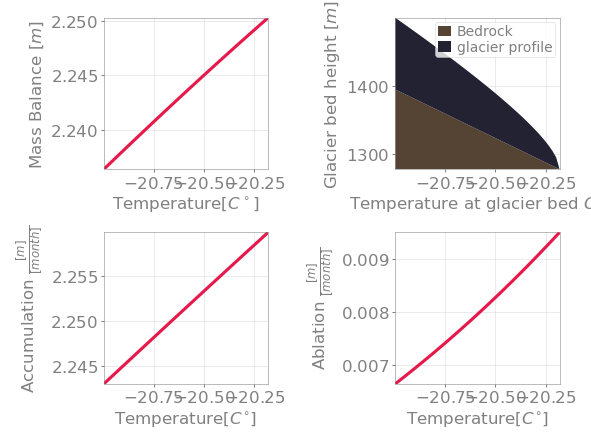

In [28]:
@nb.njit(fastmath=True)
def smb_func_test_mass(Tmonth, sigma, z, P0, p_g, T_lapse=-7 * 1e-3, PDD_factor=2 * 1e-3, cp=0.08):
    '''
    calculates the monthly surface mass balance (smb) as a function of temperature using a positive degree day (PDD) model.
    :param Tmonth: monthly mean temperature
    :param sigma: monthly mean temperature swings

    :param z: height over sea level
    :param t_lapse: temperature lapse rate
    :param PDD_factor: PDD factor
    :param P0: precipitation at sea level
    :return: smb: surface mass balance
    '''

    T_glacier_surface = float(Tmonth) + T_lapse * z
    # print(T_glacier_surface.shape)
    fPDD = normalPDD(T_glacier_surface, sigma)
    ablation = PDD_factor * fPDD * 30
    P = (P0+p_g) * np.exp(cp * (T_glacier_surface)) * 1e-3 * 30
    P = P.reshape(-1,1)
    Pcold = norm_cdf_accumulation( T_glacier_surface, sigma).reshape(-1,1)
    accumulation = P * Pcold
    # print(f'accumulation{accumulation}')
    smb = accumulation - ablation
    #
    return smb, T_glacier_surface, fPDD, accumulation, ablation





fpd= getPDD(glacier = glacier , Tmonth=out[month,2], sigma=7.5, P0=out[month,1], p_g = 90)
month = 1
out, cal = load_andprocess('ssp126', '1995-2014_hist')
m, t, f, accum, abla = smb_func_test_mass(Tmonth=out[month,2], sigma=7.5, P0=out[month,1], PDD_factor=pdd, z=zbed, p_g=90, cp = 0.01)

x = np.linspace(0,glacier.lmax_m, 50)
glacier_mean_height = np.sqrt(2 * 1e5 / (rhoi * g) * (glacier.lmax_m - x))


fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize= (4,3))

ax1.plot(t, m)
ax1.set_xlabel(r'Temperature[$C^\circ$]')
ax1.set_ylabel(r'Mass Balance $[m]$')

ax2.fill_between(t,zbed,np.min(zbed),fc='#554433', label = 'Bedrock')
ax2.fill_between(t,glacier_mean_height+zbed,zbed, fc='#223', label = 'glacier profile')
ax2.set_xlabel(r'Temperature at glacier bed $C^{\circ}$ ')
ax2.set_ylabel(r'Glacier bed height $[m]$')
ax2.legend()
ax3.plot(t, accum)
ax3.set_xlabel(r'Temperature[$C^{\circ}$]')
ax3.set_ylabel(r'Accumulation $\frac{[m]}{[month]}$')

ax4.plot(t, abla)
ax4.set_xlabel(r'Temperature[$C^{\circ}$]')
ax4.set_ylabel(r'Ablation $\frac{[m]}{[month]}$')
plt.tight_layout()


In [30]:
#To get around jit not wanting to run non jit'ed code
@njit( fastmath=True, cache = True)
def get_smb_data(T_array, h, precip_array):
    """This function will be called when JIT code calls get_smb_data"""
    return smb_func_test(Tmonth=T_array, sigma=7.5, P0=precip_array, PDD_factor=8*1e-3, z=h)

# Override the JIT function with an implementation that calls the regular smb_func
get_smb_data_jit = get_smb_data

@njit(fastmath=True )
def SIA_Simulation_jit(glacier_par,Precipitation, Temperature, Atemp, PDD_factor, phi=1, N=50, Mean_Temperature = 0, sigma = 7.5):
    '''
    Sia simulation with jit
    Parameters passed as primitive types instead of DataFrame
    '''
    # Constants
    rhoi = 900 # kg /m3
    g = 9.82 # m/s^2
    n = 3 # for glens flow law
    fs = 5.7e-20 # Pa^-3 m^2 s^-1
    sec_per_year = 365.25 * 24 * 60 * 60 # s/yr
    mon_year = 12 * 19 # months in a 19 yr climate period
    area_km2, lmax_m, zmin_m, zmax_m, zmean_m, slope_deg = glacier_par
    gamma = 1/80
    # Setting up parameters
    A = 3.985e-13 * np.exp(-60e3 / (8.31446261815324 * (273.15 - Atemp)))  # Simplified A_fun
    length = lmax_m
    minelev = zmin_m
    maxelev = zmax_m

    E = minelev + (zmean_m - minelev) * phi
    Volume = 0.067*(area_km2)**1.23 *1e9# Volume in m^3
    # print(Volume)
    # Grid setup
    x = np.linspace(0, length*2, N)
    dx = x[1] - x[0]
    zbed = maxelev - x * (maxelev - minelev) / length

    # Calculate initial height
    x_half = x[0:int(N / 2)]
    h_init = np.zeros(N)
    h_init[:int(N / 2)] = np.sqrt(2 * 1e5 / (rhoi * g) * (length - x_half))
    h = zbed + h_init
    init_area = np.trapz(h_init, x)
    width = Volume/init_area

    # Initialize arrays
    N_repeats = 80
    n_years = mon_year * N_repeats # the 20 year period times the 12 months in a year times the amount of repeats
    years = np.linspace(0, n_years, n_years)
    T_array = np.zeros(n_years)
    Precip_array = np.zeros(n_years)
    #
    # Repeating the current climate
    for i in nb.prange(n_years):
        idx = i % len(Temperature)
        T_array[i] = Temperature[idx]
        Precip_array[i] = Precipitation[idx]

    T_Y_deviation = T_array - Mean_Temperature

    height = np.zeros((len(years), N))
    height[0] = h.copy()
    Glacier_height = np.zeros((len(years), N))
    Glacier_Volume = np.zeros(len(years))
    ELA_Array = np.zeros(len(years))
    ELA_Array[0] = E


    # Main time loop
    for i in nb.prange(1, len(years)):
        # dT = T_Y_deviation[i]
        # beta  = 0.006 * np.sqrt(Precip_array[i]*1e-3)*30
        # print(beta)
        # ELA_Array[i] = ELA_Array[0] + dT / gamma

        remaining_seconds = (years[i] - years[i - 1]) * sec_per_year/12

        while remaining_seconds > 0:
            thickness = h - zbed
            dhdx = np.zeros(N - 1)

            for j in range(N - 1):
                dhdx[j] = (h[j + 1] - h[j]) / dx
            Hm = (thickness[:-1] + thickness[1:]) / 2

            tau_d = slope_deg * np.pi / 180 * rhoi * g * Hm
            Dx = 2 * A * np.abs(dhdx) ** (n - 1) * (rhoi * g) ** n * (Hm ** (n + 2)) / (n + 2)
            U_slide = fs * tau_d ** 3/Hm

            Qx = -Dx * dhdx + U_slide
            # B = (h - ELA_Array[i]) * beta /sec_per_month
            B = smb_func_test(Tmonth = T_array[i], sigma= sigma, P0 = Precip_array[i], PDD_factor=PDD_factor, z = h , p_g=90, cp=0.08)[:,0]/sec_per_month

            dhdt = np.zeros(N)
            Qx_ext = np.zeros(N + 1)
            Qx_ext[1:-1] = Qx
            for j in nb.prange(N):
                dhdt[j] = B[j] - (Qx_ext[j + 1] - Qx_ext[j]) / dx

            maxDx = np.max(Dx) if np.any(Dx) else 0
            # print(maxDx)
            maxdt = 0.25 * dx ** 2 / maxDx if maxDx > 0 else 1e7

            dt = min(remaining_seconds, maxdt)

            h += dhdt * dt
            h = np.maximum(h, zbed)

            remaining_seconds -= dt
            # print(f"Year index: {i}, Remaining seconds: {remaining_seconds}, dt: {dt}")
        # print(f'year {i} done')
        height[i] = h.copy()
        Glacier_height[i] = height[i] - zbed
        Current_area =np.trapz(Glacier_height[i],x)
        # print(Current_area)
        Glacier_Volume[i] = float(Current_area) * width


        if i > 5*mon_year:
            # Total change since beginning
            Vol_diff = np.abs(Glacier_Volume[i] - Glacier_Volume[0])

            # Total change over last 80 years
            recent_change = np.abs(Glacier_Volume[i] - Glacier_Volume[i - 4*mon_year])

            # Check if recent change is less than 10% of total change
            if recent_change < Vol_diff * 0.1 or Glacier_Volume[i] <= 0:
                # print('hey')
                return height[:i], Glacier_Volume[:i], T_Y_deviation[:i], Precip_array[:i], Volume, years[:i]

    return height, Glacier_Volume, T_Y_deviation[:i],Precip_array[:i], Volume, years


In [178]:
def simulate_glacier(glacier, scenario, period):
    area_km2_g = glacier.area_km2
    lmax_m_g = glacier.lmax_m
    zmin_m_g = glacier.zmin_m
    zmax_m_g = glacier.zmax_m
    zmean_m_g = glacier.zmean_m
    slope_deg_g = glacier.slope_deg
    glacier_para = np.array([area_km2_g, lmax_m_g, zmin_m_g, zmax_m_g, zmean_m_g, slope_deg_g])
    out, cal = load_andprocess(scenario,period)
    precip = out[:,1]
    tas = out[:,2]
    sigma = 7.5
    PDD_factor = getPDD(glacier,cal[0],sigma,cal[1], p_g=30)
    height_simulated, Volume, Temperature, Precipitation, Vol, years = SIA_Simulation_jit(glacier_para, precip, tas, 10, Mean_Temperature = cal[0], N = N, PDD_factor = PDD_factor, sigma = sigma)
    return height_simulated, Volume, Temperature,Precipitation, Vol, years

scenario = 'ssp585'
period = '1995-2014_hist'
# period = '2081-2100_hist'
glacier = Alaska.iloc[1653]
# glacier = Alaska.iloc[1299]
# print(f' z_median{glacier.zmean_m}, z_min {glacier.zmin_m}, z_max {glacier.zmax_m}')
height_simulated, Volume, Temperature, Precipitation, Vol, years = simulate_glacier(glacier, scenario, period)


/var/folders/zm/jhkrt2q10p1fy8tnqf8pvn0r0000gn/T/ipykernel_10651/1113908496.py:171: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return float(a[0])


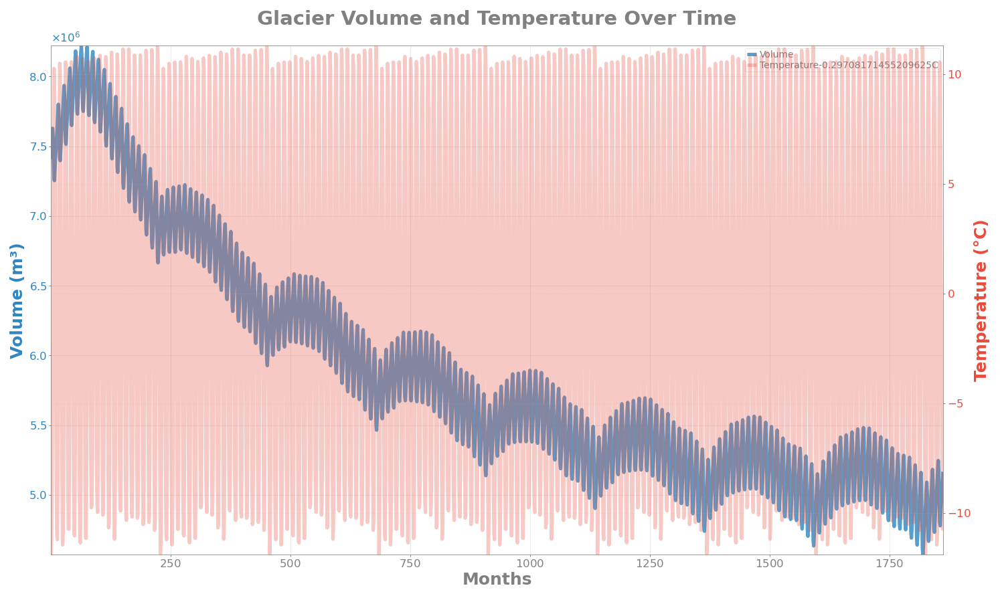

In [179]:
plt.figure(figsize=(10, 6))

# Create first y-axis for volume
ax1 = plt.gca()
ax1.plot(years[1:], Volume[1:], color='#2E86C1', linewidth=2.5, alpha=0.8, label='Volume')
ax1.set_xlabel('Months', fontsize=12, fontweight='bold')
ax1.set_ylabel('Volume (m³)', fontsize=12, fontweight='bold', color='#2E86C1')
ax1.tick_params(axis='y', labelcolor='#2E86C1')

# Create second y-axis for temperature
ax2 = ax1.twinx()
ax2.plot(years[1:], Temperature[:len(years[1:])], color='#E74C3C', linewidth=2.5, alpha=0.3, label=f'Temperature{np.mean(Temperature)}C')
ax2.set_ylabel('Temperature (°C)', fontsize=12, fontweight='bold', color='#E74C3C')
ax2.tick_params(axis='y', labelcolor='#E74C3C')

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right')

plt.title('Glacier Volume and Temperature Over Time', fontsize=14, fontweight='bold', pad=15)
plt.grid(True, linestyle='--', alpha=0.3)
plt.tight_layout()


## Running the emsemble of experiments

In [185]:
periods = ['1995-2014_hist','2021-2040_hist','2041-2060_hist', '2061-2080_hist', '2081-2100_hist']
# periods = ['1995-2014_hist', '2081-2100_hist']
Data_dict = {}
plt.style.use('../aslak.mplstyle')
# scenarios = ['ssp126','ssp245', 'ssp370', 'ssp585']
scenarios = ['ssp585']
# len(Alaska['lmax_m'])
# Sample_glaciers = Alaska[mask]
#len(Alaska.lmax_m)
for scenario in scenarios:
    Data_dict = {}
    for period in periods:
        Glacier_height_array = []
        Glacier_volume_array = []
        Temperature_array = []
        Precipitation_array = []
        Inital_volume_array = []
        Years_runtime_array = []
        for i in tqdm(range(2000), desc=f"Doing period{period} in scenario{scenario}"):
            # print(f'Period {period}, Step {i} done')
            glacier = Alaska.iloc[i]
            # glacier = Sample_glaciers.iloc[i]
            #height_simulated, Volume, Temperature, Precipitation, Vol, years
            h, Volume, t, P,Vol, y = simulate_glacier(glacier, scenario, period)
            SLE_dict = {}
            # Glacier_height_array.append(h)
            Glacier_volume_array.append(Volume)
            Temperature_array.append(t)
            Precipitation_array.append(P)
            Inital_volume_array.append(Vol)
            Years_runtime_array.append(y)
        # Total_MSe = np.sum(MSe_array)
        Data_dict[period] = {
                             'Glacier volume' : Glacier_volume_array,
                             'Temperature'    : Temperature_array,
                             'Precipitation'  : Precipitation_array,
                             'Initial volume' : Inital_volume_array,
                             'Years runtime'  : Years_runtime_array,
                             'Glacier index'  : i}
        #     Data_dict[period] = {
        #                  'Glacier volume' : Glacier_volume_array,
        #                  'Initial volume' : Inital_volume_array,
        #                  'Years runtime'  : Years_runtime_array,
        #                  'Glacier index'  : random_index}

    with open(f'Data_dict_{scenario}_{period}alaska_PDD_Glaciers_precip_offset_test.pkl', 'wb') as f:
        pickle.dump(Data_dict, f)


Doing period1995-2014_hist in scenariossp585:   0%|          | 0/2000 [00:00<?, ?it/s]

/var/folders/zm/jhkrt2q10p1fy8tnqf8pvn0r0000gn/T/ipykernel_10651/1113908496.py:171: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return float(a[0])


Doing period2021-2040_hist in scenariossp585:   0%|          | 0/2000 [00:00<?, ?it/s]

Doing period2041-2060_hist in scenariossp585:   0%|          | 0/2000 [00:00<?, ?it/s]

Doing period2061-2080_hist in scenariossp585:   0%|          | 0/2000 [00:00<?, ?it/s]

Doing period2081-2100_hist in scenariossp585:   0%|          | 0/2000 [00:00<?, ?it/s]

## Making an animation of the glacier experiment


In [132]:

def render_frame(frame_index):
    ax = plt.gca() # we always want to plot in the current axes
    plt.cla()
    plt.ylim((np.min(zbed),np.max(height_simulated)*1.002))
    my_fill = plt.fill_between(x,zbed,np.min(zbed),fc='#554433')
    ice_fil = plt.fill_between(x,height_simulated[frame_index,:],zbed, fc='#223')

    # v_line = plt.axhline(ELA_Array[frame_index], color='#223', linestyle='--')
    # text = ax.text(x[-1], ELA_Array[frame_index], f'ELA{ELA_Array[frame_index]:.1f}[m]', verticalalignment='bottom', horizontalalignment='right', color='#223')
    plt.ylabel('z (m)')
    plt.xlabel('x (m)')
    my_title = ax.set_title(f'Frame {frame_index}')
    plt.tight_layout()
    return my_fill, ice_fil, my_title

plt.figure(figsize=(10,10))
plt.tight_layout()
# Create the animation object
anim = animation.FuncAnimation(plt.figure(), render_frame, frames=len(height_simulated[1000:1500,0]), interval=20, repeat=False)

# Show the animation
display(HTML(anim.to_jshtml()))
plt.close()

Animation size has reached 21177539 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<Figure size 1500x1500 with 0 Axes>

In [14]:
Alaska.iloc[23]

rgi_id        RGI2000-v7.0-G-01-00024
o1region                            1
o2region                        01-01
glims_id               G205498E67458N
anlys_id                       393088
subm_id                           624
src_date          2008-09-02T00:00:00
cenlon                    -154.498266
cenlat                      67.459093
utm_zone                            5
area_km2                     0.559205
primeclass                          0
conn_lvl                            0
surge_type                          0
term_type                           9
glac_name                         NaN
is_rgi6                             1
termlon                   -154.495285
termlat                     67.463722
zmin_m                      1394.8613
zmax_m                      1877.2274
zmed_m                      1507.3688
zmean_m                     1518.0239
slope_deg                   23.391735
aspect_deg                   0.296659
aspect_sec                          1
dem_source  